# $N$ coupled pendulums: Normal modes
## Juan David Salcedo Hernández
## Also available at [this link](https://jdavid-salcedo.github.io/Metodos_Computacionales_taller/public/FinalProject.html)
____

In [1]:
%config InlineBackend.figure_format = 'svg'

import numpy as np
import matplotlib.pyplot as plt

### Theoretical considerations
(The following discussion is partially based on Spivak's book [[Spvk]](#References) )

Many physical systems can be thought of as a collection of oscillators
influencing each other in potentially quite complex ways. Such behaviours can
certainly arise, even in one of the simplest such systems, namely, two pendulums
of the same mass $m$ and length $l$, connected by a spring with sping constant
$\kappa$, whose unstreched length is the distance between the two pendulums when
they are in vertical (equilibrium) position.
![Coupled pendulums](https://raw.githubusercontent.com/jdavid-salcedo/Metodos_Computacionales_taller/main/Tareas/Entrega_tareas_2021/1001577699/posts/media/coupled_drawing_light.svg)

Let us momentarily work with the small-angle approximation, so as to make the
general discussion simpler. Letting $K := \kappa/m$ and $\omega_0 = \sqrt{g/l},$
the displacements of the two pendulums from their vertical positions can be
written as the pair of equations
\begin{gather*}
{x_1}'' + {\omega_0}^2 x_1 = -K(x_1 - x_2), \\
{x_2}'' + {\omega_0}^2 x_2 = -K(x_2 - x_1).
\end{gather*}

These may be solved, provided some initial conditions, with the help of various
mathematical tricks. However, it is usual to investigate the most "obvious"
solutions thereof, where the pendulums either move in sync ($x_1 = x_2$) or in
anti-sync ($x_1 = -x_2$).

Synchronised motion leads to identical equations
\begin{equation} {x_k}'' + {\omega_0}^2 x_k = 0, \end{equation}
so that both pendulums have a frequency $\omega_0$ with
\begin{equation} x_1(t) = x_2(t) = a \cos \omega_0 t + b \sin \omega_0 t, \end{equation}
for some real numbers $a, b$.

Anti-sync motion, on the other hand, leads to the equations
\begin{equation} {x_i}'' + {\omega_0}^2 x_i = -2 K x_i, \end{equation}
which is to say that both pendulums have a frequency
\begin{equation} {\omega_0}^+ := \sqrt{{\omega_0}^2 + 2K}; \end{equation}
ultimately giving
\begin{gather*}
x_1(t) = c \cos {\omega_0}^+ t + d \sin {\omega_0}^+ t, \\
x_2(t) = -c \cos {\omega_0}^+ t - d \sin {\omega_0}^+ t.
\end{gather*}

Such solutions, known as the /normal modes/ of the system, are particularly
interesting because the pendulums have the /same period/. As a matter of fact,
combinations of the two normal modes,
\begin{gather*}
x_1(t) = a \cos \omega_0 t + b \sin \omega_0 t + c \cos {\omega_0}^+ t + d \sin {\omega_0}^+ t, \\
x_2(t) = a \cos \omega_0 t + b \sin \omega_0 t - c \cos {\omega_0}^+ t - d \sin {\omega_0}^+ t,
\end{gather*}
with four arbitrary constants $a,b,c,d$, will give us a solution with any
desired initial conditions $x_k(0), {x_k}'(0)$.

Generalisations of these considerations to $N$ harmonic oscillators, all
interacting in a linear way, is easy. If we have $n$ possibly different masses,
$m_i$ and lengths $l_i$, by setting
\begin{equation} K_k = \frac{\kappa}{m_k} \quad {\omega_k}^2 = \frac{g}{l_k}, \end{equation}
we should get $N$ equations of the form
\begin{equation}
{x_k}''(t) + {\omega_k}^2 x_k(t) = \sum_{l=1}^N a_{kl}x_l, \quad k = 1,\ldots,N;
\tag{1}
\end{equation}
where each $a_{il}$ is some real number depending on some $K_k$.

In this case, for a normal mode, we get complex solutions
\begin{equation} x_k(t) = c_k e^{i \lambda t}, \quad k = 1,\ldots,N; \end{equation}
whose real part represnt the motion of the $N$ oscillators. Hence we must have:
\begin{equation} -\lambda^2 c_k e^{i \lambda t} + {\omega_k}^2 c_k e^{i \lambda t}  = \sum_{l=1}^N a_{kl} c_l e^{i \lambda t}, \quad k = 1,\ldots,N; \end{equation}
which can be rewritten as
\begin{equation} -\lambda^2 c_k = \sum_{l=1}^N a_{kl} c_l - c_k {\omega_k}^2, \quad k = 1,\ldots,N. \end{equation}
In matrix form, this may be seen as
\begin{equation} \lambda^2 \begin{pmatrix} c_1 \\ \vdots \\ c_N \end{pmatrix}
= \left[ \begin{pmatrix} {\omega_1}^2 &  & 0 \\  & \ddots &  \\ 0 &  & {\omega_N}^2 \end{pmatrix} - \begin{pmatrix} a_{11} & \cdots & a_{1N} \\ \vdots & \ddots & \vdots \\ a_{N1} & \cdots & a_{NN} \end{pmatrix} \right] \begin{pmatrix} c_1 \\ \vdots \\ c_N \end{pmatrix}. \end{equation}
Therefore, it is clear that $\lambda^2$ is an eigenvalue of the matrix in
brackets, while each $c_i$ is a component of the corresponding eigenvector. Our
problem (that of finding the normal modes) amounts to solving an eigenvalue
problem depending on the parameters of the system. Of course, the matrix in
brackets turns out to be symmetric, so the spectral theorem tells us that it is
diagonalisable, and that there exists a basis of eigenvectors with real
eigenvalues.

Notice that the aforementioned discussion was given in terms of arbitrary
parameters $a_{kl}$, yet we wish to address the particular case of $n$
coupled pendulums. Luckily, we have the apparatus of Newton's second law, which
will help us find the parameters that should be used in our equation.

Let us suppose that the separation between any three pendulums is the same and
such that we can safely ignore any small inclination in the direction towards
which the sping forces are oriented. With these considerations, we essentialy have
\begin{align*}
F_{k,\text{springs}} &= -\kappa(x_k - x_{k-1}) + \kappa(x_{k+1} - x_k), \\
&= \kappa(x_{k-1} - 2x_k + x_{k+1}).
\end{align*}
Thus equation (1) turns into
\begin{align*}
{x_k}''(t) + {\omega_k}^2 x_k(t) &= \frac{\kappa}{m_k} (x_{k-1} - 2x_k + x_{k+1}), \quad k = 1,\ldots,N, \\
&:= K_k (x_{k-1} - 2x_k + x_{k+1}), \quad k = 1,\ldots,N;
\end{align*}
and so for a normal mode we have:
\begin{equation} \lambda^2 \begin{pmatrix} c_1 \\ \vdots \\ c_N \end{pmatrix}
= \left[ \begin{pmatrix} {\omega_1}^2 &  & 0 \\  & \ddots &  \\ 0 &  & {\omega_N}^2 \end{pmatrix} +
\begin{pmatrix} 2K_1 & -K_1 & 0 & 0 & \cdots \\ -K_2 & 2K_2 & -K_2 & 0 & \cdots \\ 0 & -K_3 & 2K_3 & -K_3 & \cdots \\ \vdots & \vdots & \vdots & \vdots & \end{pmatrix} \right]
\begin{pmatrix} c_1 \\ \vdots \\ c_N \end{pmatrix}. \end{equation}
Hence we just need to solve the aforementioned eigenvalue problem with this
matrix in particular.


#### Numerical implementation
We define a class that allows us to find the normal modes for a system of
coupled pendulums, specified by the elastic constant, their masses, and the
lengths of their pivots.

In [2]:
g = 9.8

class CoupledPendulums:
    def __init__(self, elastic_constant, masses, lengths):
        ''' Initialise the system with the required attributes '''
        if len(masses) != len(lengths):
            raise ValueError('masses and lengths must have the same size')
        else:
            self.elastic_constant = elastic_constant
            self.masses = np.asarray(masses, dtype=float)
            self.lengths = np.asarray(lengths, dtype=float)
            self.N = len(masses)

    def normal_modes_matrix(self):
        '''
        Provided a system of coupled pendulums, returns the stiffness matrix,
        whose eigenvalues and eigenvectors characterise the system's normal
        modes
        '''
        K = self.elastic_constant/self.masses
        omega_squared = g/self.lengths

        matrix = np.zeros((self.N, self.N), dtype=float)
        for i in range(self.N):
            if i-1 < 0:
                matrix[i,i] = K[i]
                matrix[i,i+1] = -K[i]
            else:
                try:
                    matrix[i,i] = 2*K[i]
                    matrix[i,i-1] = -K[i]
                    matrix[i,i+1] = -K[i]
                except IndexError:
                    matrix[i,i] = K[i]
                    matrix[i,i-1] = -K[i]

        return np.diag(omega_squared) + matrix

    def normal_modes(self, time_domain=np.linspace(0,100,1000)):
        M = self.normal_modes_matrix()
        frequencies_squared, amplitudes_matrix = np.linalg.eig(M)
        frequencies = np.sqrt(frequencies_squared)
        amplitudes = amplitudes_matrix.T

        # A list of N matrices of dimension N x len(time)
        x_coords = np.zeros((self.N, self.N, len(time_domain)))
        y_coords = np.zeros((self.N, self.N, len(time_domain)))
        # Now we fill in the data
        for i in range(self.N):
            for j in range(self.N):
                complex_exponential = amplitudes[i,j] * \
                    np.exp(complex(0,1)*frequencies[i]*time_domain)
                x_coords[i,j] = complex_exponential.real
                y_coords[i,j] = self.lengths[i] - \
                    np.sqrt(self.lengths[i]**2 - x_coords[i,j]**2)
        return x_coords, y_coords

The above defined class can be used, in particular, to obtain the normal modes for
a system of five pendulums:

In [3]:
time = np.linspace(0,30,500)
system = CoupledPendulums(1, [5]*5, [1]*5)
x_coords, y_coords = system.normal_modes(time_domain=time)

We have five normal modes, the first one of which is the following:

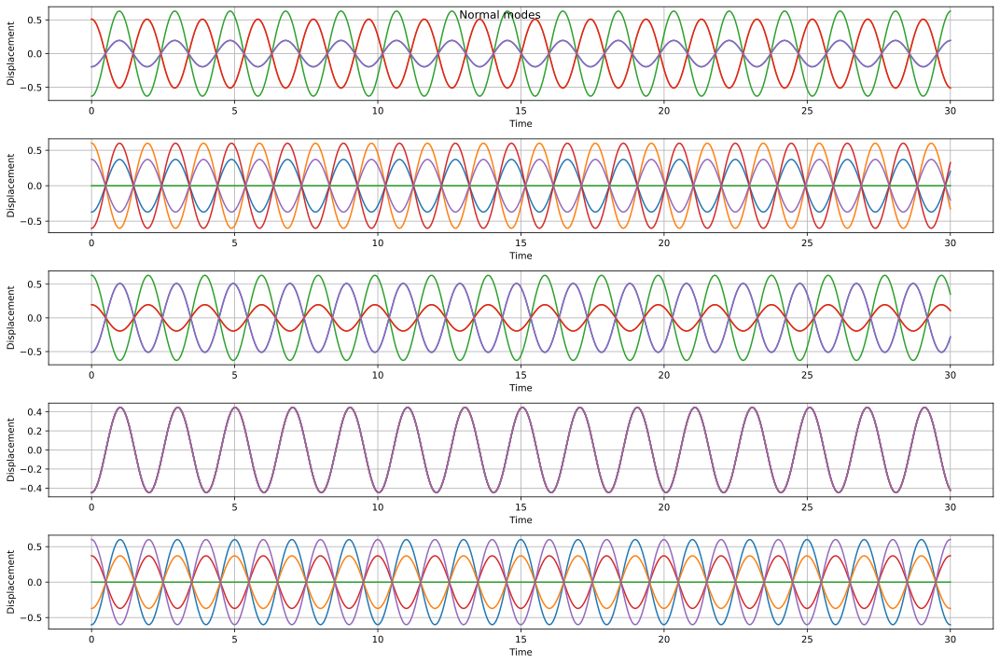

In [4]:
fig, axs = plt.subplots(5,figsize=(15,10), tight_layout=True)
fig.suptitle('Normal modes')

for i in range(5):
    for j in range(5):
        # ax = fig.add_subplot(4, 2, i+1)
        axs[i].plot(time, x_coords[i,j])
        axs[i].set_xlabel('Time')
        axs[i].set_ylabel('Displacement')
        axs[i].grid()

We now present an animation of the normal modes for the aforementioned five-mass
configuration. Of course, the approximation we allowed ourselves to use in
previous computations becomes more reasonable as the distance between the masses
increases, but for visualisation purposes alone we've laid out our pendulums
with a rather small separation between them.

In [9]:
from matplotlib import animation
# Additional libraries to embed the animation in the jupyter notebook
from matplotlib import rc
rc('animation', html='jshtml')

N = len(time)
dt = time[1] - time[0]

fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5,1, figsize=(13,12))
fig.suptitle('Normal modes')
# We initialise the arrays containing oscillators, lines, and springs. These are
# matrices, where the rows represent the possible normal modes (frames), and the
# columns represent the amount of objects (oscillators, lines, or springs) in
# each frame. Of course, in this case, there are five frames with five
# oscillators, five lines, and four connecting springs
oscillators = np.zeros((5,5), dtype=object)
lines = np.zeros((5,5), dtype=object)
springs = np.zeros((5,4), dtype=object)

for i, axis in enumerate([ax1, ax2, ax3, ax4, ax5]):
    for j in range(5):
        oscillators[i,j], = axis.plot([], [], lw=0, ms=20, marker='o', mfc='gray', fillstyle='full', mec='black', markevery=2)
        lines[i,j], = axis.plot([], [], lw=1, color='k')
        try:
            springs[i,j], = axis.plot([], [], lw=1, color='k')
        except IndexError:
            continue

    axis.axis('equal')
    axis.set_ylim(-0.5, y_coords.max()+1)
    axis.set_xlim(-1, 9)
    axis.set_xlabel('x')
    axis.set_ylabel('y')

def init_animation():
    ''' Initialise the animation as an empty object '''
    for i in range(5):
        for j in range(5):
            oscillators[i,j].set_data([], [])
            lines[i,j].set_data([], [])
            try:
                springs[i,j].set_data([],[])
                yield springs[i,j]
            except:
                continue

            yield lines[i,j]
            yield oscillators[i,j]

def animate(k):
    # distance between the oscillators
    distance = 2
    for i in range(5):
        for j in range(5):
            oscillators[i,j].set_data([distance*j + x_coords[i,j,k], 0], [y_coords[i,j,k], 0])
            lines[i,j].set_data([distance*j, distance*j + x_coords[i,j,k]], [1, y_coords[i,j,k]])
            try:
                springs[i,j].set_data([distance*j + x_coords[i,j,k], distance*(j+1) + x_coords[i,j+1,k]], [y_coords[i,j,k], y_coords[i,j+1,k]])
                yield springs[i,j]
            except:
                continue

            yield lines[i,j]
            yield oscillators[i,j]

ani = animation.FuncAnimation(fig, animate, np.arange(1, N),
                              interval=50, blit=True, init_func=init_animation,repeat=False)
plt.close()
ani

Animation size has reached 21021198 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# References
<a id='ref'></a>

\[Spvk] Spivak, Michael. Physics for mathematicians: Mechanics I. Publish or Perish, 2010.
